# №0. Добро пожаловать в царство генераций  
# (ﾉ◕ヮ◕)ﾉ*:･ﾟ✧

# №1. Некоторые подробности о сборе данных Гречневого датасета и дообучения модели YOLO8n от ultralytics

Итак к подробностям.
1. Все примеси выделяем в один класс, как видно на картинке, по сути это два класса (если не больше), черные штуки + крупные серые камешки и уродливые крупинки.
2.  Датасет состоит из фотографий гречки с примесями. Я перебрал стандартную упаковку гречки (900 гр), выбрал примеси и затем небольшое количество примесей перемешивал с чистой гречкой и фотографировал.
Качество фото - 3060 * 4080.
Количество фото - 348 шт.
Фото делались с расстояния 8-10 см над поверхностью с гречкой, под углом в 15 градусов (с расчетом на то, что "сканирование" гречки с помощью приложения с моделью будет осуществляться примерно на такой высоте).
3.  Модель YOLO от ultralytics требует специального формата датасета + yaml файл с характеристиками датасета.
Формат имеет вид - папка dataset с двумя папками images (фотографии) и labels (разметка) и в каждой из этих папок есть 3 папки train, val и test.
4. Для разметки изображений было использовано приложение labellmg, т.к. roboflow не очень хотел работать. (Рекомендую устанавливать labellmg не через консоль, а скачать с гитхаба архив и из него вытащить exe файл).
5. Т.к. labellmg только размечает фото, то для создание требуемого для YOLO формата потребовалось перемешать изображения и разметки и разложить их по вышеописанным папкам + создать yaml файл. Фотографии разместились по папкам в соотношении 80:15:5 соответственно.
6. Мы используем transfer learning (дообучаем готовую модель), но оказывается (напомним, что решение YOLO8n от ultralytics "в коробке") , что число замораживаемых слоёв можно передать в качестве параметра в методе для обучения .train. Например, model.train(data=data_yaml, freeze = 10). Но отметим, что модель замораживает не слоями, а модулями и это логично, т.к. архитектура состоит из блоков и замораживание их частей может нарушать логику и снижать эффективность модели.
7. Также в качестве параметра метода train можно передать желаемую аугментацию (это методы изменения картинок для увеличения размера датасета без риска переобучения). В нашем случае из 278 фотографий для тренировки мы получаем с помощью аугментации 640 фотографий.
8. Далее в среде google collab, используя gpu от него, проводим обучение модели и получаем следующие лучшие метрики на 15 эпохе (т.е. модель 15 раз обучилась на всем тренировочном датасете):

P          R             mAP50   mAP50-95  F1  
0.89      0.682      0.798      0.413          0.77  
Т.е. полнота (recall) - доля выявленных примесей равна 0.682.  
Вероятность (precision - точность), что отмеченные как примеси объекты таковыми являются - 0.89. Конечно, хотелось больший recall, в ущерб ложноположительности, но в силу редкости примесей (если одна крупинка весит 0.022 гр, а в упаковке 900 гр, то если всех примесей 80 шт, то отношение нормальной гречки к примесям в упаковке - 99.8 : 0.2) может обрушится precision (детектор слишком много будет показывать объектов и потеряется смысл использования средства автоматизации).  
Также при равной важности точности и полноты (метрика F1) максимум достигается при степени уверенности conf =  0.177 (т.е. если оценка нахождения объекта в рамке меньше conf, то считаем что объекта в рамке нет), и в правду, при использовании модели в real time при conf = 0.1 порой было многовато ложных срабатываний, а после conf = 0.25 срабатываний становилось маловато.  



# №2. Формирование из размеченного (в программе labellmg) датасета трёх выборок в формате YOLO (+ data.yaml):
- train
- valid
- test

In [ ]:
# Пример представление датасета в формате данных YOLO:

"""
    dataset/
    ├── images/
    │   ├── train/
    │   │   ├── image1.jpg
    │   │   └── image2.jpg
    │   └── val/
    │       ├── image3.jpg
    │       └── image4.jpg
    └── labels/
        ├── train/
        │   ├── image1.txt
        │   └── image2.txt
        └── val/
            ├── image3.txt
            └── image4.txt
"""

In [ ]:
# Пример data.yaml:

"""
train: /path/to/your/dataset/images/train # Path to training images
val: /path/to/your/dataset/images/val   # Path to validation images
test: /path/to/your/dataset/images/test # Optional: Path to test images

nc: 2 # Number of classes

names: ['class1', 'class2'] # List of class names, in order of their indices

"""

1. Шаг по разбивке датасета на выборки лучше выполнять не на gpu коллаба, чтобы не расходовать ограниченные ресурсы!
2. Также можно загрузить датасет в коллаб или на комп и обрабатывать его из этих директорий, это быстрее, чем чтение с диска. В таком случае измените пути в ячейке кода.

In [ ]:
import os
import shutil
import random

# Датасет на Hugging Face https://huggingface.co/datasets/Paradise151/GrechnikDataset
# -1. Можно загрузить датасет в коллаб, чтение файлов из коллаба быстрее, чем с гугл диска.
from google.colab import drive
drive.mount('/content/drive')



# 0. Программа для разбиения датасета на три выборки: тренировочную, валидационную и тестовую. seed = 42 для воспроизводимости.
# 1. Выполнено в google collab!
# 2. В папке labels есть файл classes (создаётся при разметке в labellmg). Его удали!!



# --- Настройка путей ---
# Папка, где находятся все ваши изображения после разметки
source_images_dir = '/content/drive/My Drive/dataset/grechka'
# Папка, где находятся все ваши .txt файлы аннотаций после разметки
source_labels_dir = '/content/drive/My Drive/dataset/labels'

# Папка, куда будет создан новый датасет в структуре YOLO
destination_base_dir = '/content/drive/My Drive/yolo_grechka_dataset'

# --- Настройка соотношений разбивки ---
train_ratio = 0.8  # 80% для тренировки
val_ratio = 0.15 # 15% для валидации
test_ratio = 0.05  # 5% для теста (убедитесь, что сумма равна 1.0)

# --- Создание структуры папок YOLO ---
os.makedirs(os.path.join(destination_base_dir, 'images', 'train'), exist_ok=True)
os.makedirs(os.path.join(destination_base_dir, 'images', 'val'), exist_ok=True)
os.makedirs(os.path.join(destination_base_dir, 'images', 'test'), exist_ok=True)
os.makedirs(os.path.join(destination_base_dir, 'labels', 'train'), exist_ok=True)
os.makedirs(os.path.join(destination_base_dir, 'labels', 'val'), exist_ok=True)
os.makedirs(os.path.join(destination_base_dir, 'labels', 'test'), exist_ok=True)

# --- Получение списка всех изображений ---
# Фильтруем только файлы изображений (можно добавить другие расширения, если нужно)
image_files = [f for f in os.listdir(source_images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp'))]

# Перемешиваем список изображений для случайного разбиения
random.seed(42) # Для воспроизводимости результатов
random.shuffle(image_files)

# --- Вычисление количества файлов для каждого набора ---
total_files = len(image_files)
train_count = int(total_files * train_ratio)
val_count = int(total_files * val_ratio)
test_count = total_files - train_count - val_count # Оставшиеся идут в тест

print(f"Всего изображений: {total_files}")
print(f"Для тренировки: {train_count}")
print(f"Для валидации: {val_count}")
print(f"Для теста: {test_count}")

# --- Разбиение и копирование файлов ---
current_index = 0

# Копирование для тренировочного набора
for i in range(train_count):
    img_file = image_files[current_index]
    base_name, ext = os.path.splitext(img_file)
    label_file = base_name + '.txt' # Имя соответствующего файла аннотации

    # Копируем изображение
    shutil.copy(os.path.join(source_images_dir, img_file), os.path.join(destination_base_dir, 'images', 'train', img_file))
    # Копируем файл аннотации (проверяем его наличие)
    if os.path.exists(os.path.join(source_labels_dir, label_file)):
         shutil.copy(os.path.join(source_labels_dir, label_file), os.path.join(destination_base_dir, 'labels', 'train', label_file))
    else:
         print(f"Внимание: Файл аннотации для {img_file} не найден в {source_labels_dir}. Изображение скопировано, но без метки.")


    current_index += 1

# Копирование для валидационного набора
for i in range(val_count):
    img_file = image_files[current_index]
    base_name, ext = os.path.splitext(img_file)
    label_file = base_name + '.txt'

    shutil.copy(os.path.join(source_images_dir, img_file), os.path.join(destination_base_dir, 'images', 'val', img_file))
    if os.path.exists(os.path.join(source_labels_dir, label_file)):
        shutil.copy(os.path.join(source_labels_dir, label_file), os.path.join(destination_base_dir, 'labels', 'val', label_file))
    else:
        print(f"Внимание: Файл аннотации для {img_file} не найден в {source_labels_dir}. Изображение скопировано, но без метки.")

    current_index += 1

# Копирование для тестового набора
for i in range(test_count):
    img_file = image_files[current_index]
    base_name, ext = os.path.splitext(img_file)
    label_file = base_name + '.txt'

    shutil.copy(os.path.join(source_images_dir, img_file), os.path.join(destination_base_dir, 'images', 'test', img_file))
    if os.path.exists(os.path.join(source_labels_dir, label_file)):
        shutil.copy(os.path.join(source_labels_dir, label_file), os.path.join(destination_base_dir, 'labels', 'test', label_file))
    else:
        print(f"Внимание: Файл аннотации для {img_file} не найден в {source_labels_dir}. Изображение скопировано, но без метки.")

    current_index += 1

print("\nРазбиение датасета завершено.")
print(f"Датасет в формате YOLO создан по пути: {destination_base_dir}")

# --- Создание placeholder data.yaml файла (нужно будет заполнить классами) ---
data_yaml_content = f"""
train: ../images/train
val: ../images/val
test: ../images/test # Опционально, если вы разбили на тест
nc: 1 # Укажите количество ваших классов
names: ['impurity'] # Укажите названия ваших классов в списке
"""

data_yaml_path = os.path.join(destination_base_dir, 'data.yaml')
with open(data_yaml_path, 'w') as f:
    f.write(data_yaml_content)

print(f"Создан placeholder data.yaml файл: {data_yaml_path}")
print("!!! ВАЖНО: Отредактируйте data.yaml файл, указав правильное количество и названия ваших классов. !!!")


Mounted at /content/drive
Всего изображений: 348
Для тренировки: 278
Для валидации: 52
Для теста: 18

Разбиение датасета завершено.
Датасет в формате YOLO создан по пути: /content/drive/My Drive/yolo_grechka_dataset
Создан placeholder data.yaml файл: /content/drive/My Drive/yolo_grechka_dataset/data.yaml
!!! ВАЖНО: Отредактируйте data.yaml файл, указав правильное количество и названия ваших классов. !!!


# №3. Дообучение модели YOLO8n на гречневом датасете

Модель YOLO8n обучена на датасете COCO.
COCO имеет train с 118287 изображений и 80 классами. Поэтому ради уменьшения времени обучения и для использования хорошо обученных глубоких слоёв, выделяющих рамки, границы и другие примитивы, логично часть слоёв нейронки заморозить и обучать оставшиеся веса на своём наборе данных.

In [ ]:
!pip install ultralytics --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 21.0 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import torch
import os

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# **FREEZE**
Ручная заморозка (но тут она не нужна, т.к. в виде параметра передаётся число замораживаемых слоёв в метод train модели yolo8n от ultralytics). Отметим, что метод train() замораживает целые "модули", а не привычные слои.

In [ ]:
# Загрузка предобученной модели
abc = YOLO('yolov8n.pt')

# Определяем слои для заморозки (все, кроме последнего)
# В YOLOv8 слои индексируются с 0. Detect Layer - это 22-й слой (индекс 22).
# Мы хотим заморозить слои с 0 по K включительно. Например, 20
freeze_layers_indices = [f"model.{i}." for i in range(20)]

# Проходимся по всем параметрам модели и устанавливаем requires_grad
for name, param in abc.named_parameters(): # Применяем заморозку к объекту 'abc'
    param.requires_grad = True # Сначала делаем все параметры обучаемыми

    # Если имя параметра начинается с префикса замораживаемого слоя, замораживаем его
    if any(f'model.{id}.' in name for id in range(20)):
        param.requires_grad = False
        print(f"Заморожен слой: {name}")

# Проверяем, что только параметры 20-го слоя требуют градиентов
print("\nПроверка статуса requires_grad:")
for name, param in abc.named_parameters(): # Проверяем объект 'abc'
    if param.requires_grad:
        print(f"Слой требует градиента: {name}") # Слои, которые будут обучаться
    else:
        print(f"Слой НЕ требует градиента: {name}") # Замороженные слои

# Продолжение...

In [ ]:
# --- 1. Загрузка предобученной модели ---
model = YOLO('yolov8n.pt')

# Проверка, доступен ли GPU
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Используется устройство: {device}')
model.to(device)

# --- 2. Обучение на датасете гречневом ---
# Указываем путь к YAML файлу. Вообще говоря os.path.join(...) нужен скорее при создании yaml файла...
# data_yaml_path = os.path.join('/content/drive/MyDrive/yolo_grechka_dataset', '/content/drive/MyDrive/yolo_grechka_dataset/data.yaml')

# Случай, когда файл на диске
data_yaml_path = '/content/drive/MyDrive/yolo_grechka_dataset/data.yaml'

# # Случай, когда файл загружен в коллаб
# data_yaml_path = '/content/yolo_grechka_dataset/data.yaml'


Используется устройство: cuda


1. Для экономии бессплатного времени на gpu коллаба, сохраните разбитый на выборки датасет на комп или в коллаб!!!

In [ ]:
# Быстрое обучение с упором на recall
results = model.train(
    data=data_yaml_path,  # путь к вашему dataset.yaml
    epochs=50,              # меньше эпох
    patience=10,            # ранняя остановка после 5 эпох без улучшений
    batch=16,               # размер батча
    imgsz=640,
    # 416,                  # меньший размер изображения для скорости
    lr0=0.01,               # больший learning rate
    lrf=0.01,               # финальный LR = 0.01 * lr0
    momentum=0.9,           # стандартный momentum
    weight_decay=0.0005,    # регуляризация
    warmup_epochs=2,        # прогрев
    warmup_momentum=0.8,    # momentum во время прогрева
    box=0.05,               # вес для bbox loss
    cls=0.3,                # вес для classification loss
    dfl=0.5,                # вес для distribution focal loss
    hsv_h=0.015,            # аугментация: оттенок
    freeze = 10,
    hsv_s=0.7,              # аугментация: насыщенность
    hsv_v=0.4,              # аугментация: яркость
    degrees=10.0,           # аугментация: повороты
    translate=0.1,          # аугментация: смещения
    scale=0.5,              # аугментация: масштабирование
    shear=2.0,              # аугментация: наклон
    perspective=0.001,      # аугментация: перспектива
    flipud=0.0,             # аугментация: отражение по вертикали
    fliplr=0.5,             # аугментация: отражение по горизонтали
    mosaic=0.0,             # ВЫКЛЮЧАЕМ мозаику для скорости
    mixup=0.0,              # ВЫКЛЮЧАЕМ mixup для скорости
    copy_paste=0.0,         # ВЫКЛЮЧАЕМ copy-paste для скорости
    erasing=0.0,            # ВЫКЛЮЧАЕМ random erasing для скорости
    save=True,
    save_period=5,
    cache=False,            # ВЫКЛЮЧАЕМ кэширование для экономии памяти
    workers=2,              # меньше воркеров для стабильности
    device=0 if torch.cuda.is_available() else 'cpu',  # GPU если есть
    optimizer='SGD',        # SGD быстрее сходится при замороженных слоях
    seed=42,
    deterministic=True,
    val=True,
    plots=True,             # строим графики
    verbose=True
)

Ultralytics 8.3.223 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=0.05, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.3, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/yolo_grechka_dataset/data.yaml, degrees=10.0, deterministic=True, device=0, dfl=0.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.0, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.9, mosaic=0.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=10, perspective=0.001

Метод train находит лучшую модель по метрике mAP50

Далее нужно сохранить/скачать себе лучшую модель.

# №4 Загрузка дообученной модели для дальнейшего использования

In [ ]:
best_model_path = '/content/runs/detect/train/weights/best.pt'

# Загружаем модель
loaded_model = YOLO(best_model_path)

print(f"Модель успешно загружена из: {best_model_path}")

Модель успешно загружена из: /content/runs/detect/train/weights/best.pt


У модели можно выставить два важных параметра - степень уверенности conf (т.е. результаты с conf > выставленного мы считаем за реальные объекты) и iou - степень пересечения bounding boxes до которого считаем, что bounding boxes относятся к разным объектам.

In [ ]:
# Пример выставления conf и iou
correct_model = loaded_model(conf = 0.25, iou = 0.7)

# №5 Применение модели

 # Применение модели к изображению. Задача детекции с отрисовкой ограничивающих рамок вокруг целевых объектов на изображении.


image 1/1 /content/IMG_20251014_231830.jpg: 640x480 2 impuritys, 107.7ms
Speed: 2.3ms preprocess, 107.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)


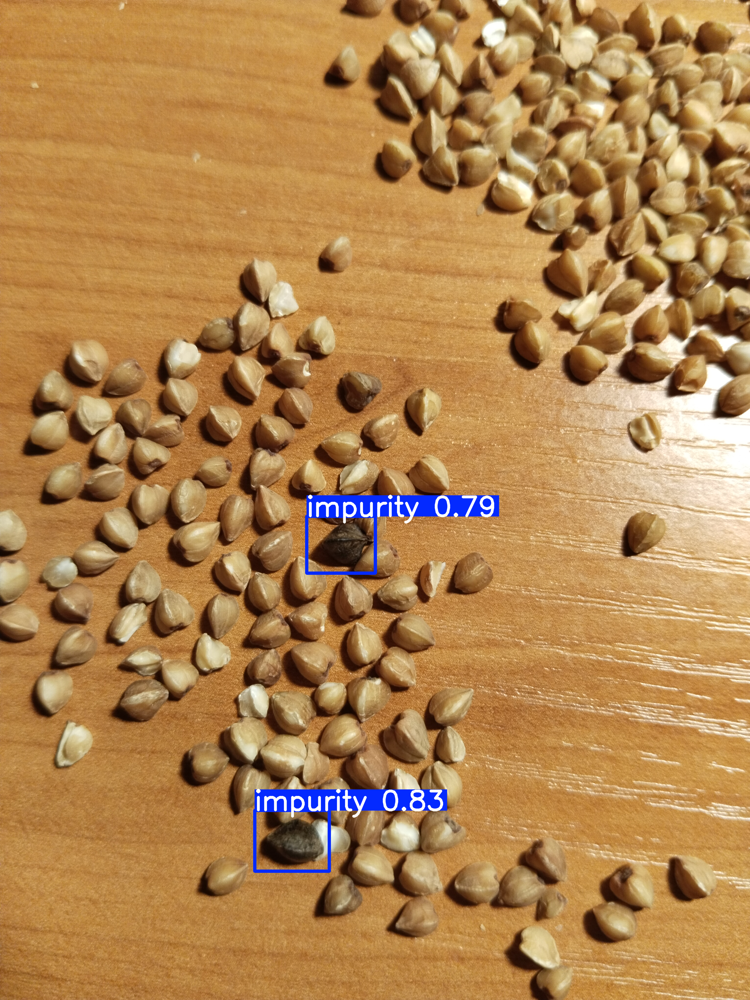

In [ ]:
# Load a model
# Run batched inference on a list of images
results = loaded_model("/content/IMG_20251014_231830.jpg", conf=0.25, iou=0.4)  # return a list of Results objects

# Process results list
for result in results:
    # boxes = result.boxes  # Boxes object for bounding box outputs
    # masks = result.masks  # Masks object for segmentation masks outputs
    # keypoints = result.keypoints  # Keypoints object for pose outputs
    # probs = result.probs  # Probs object for classification outputs
    # obb = result.obb  # Oriented boxes object for OBB outputs
    # if result not in ['names', 'probs']:
    result.show(conf=True, labels=True)  # display to screen
    # result.save(filename="result.jpg")  # save to disk

# Применение модели к папке с изображениями

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
best_model_path = '/content/best.pt'

# Загружаем модель
loaded_model = YOLO(best_model_path)

In [ ]:
import os
from PIL import Image
import cv2
from IPython.display import display

# --- Укажите путь к папке с изображениями, которые вы хотите обработать ---
# Например, путь к вашей валидационной папке на Google Диске
images_folder_path = '/content/drive/MyDrive/yolo_grechka_dataset/images/test' # !!! ОБНОВИТЕ ЭТОТ ПУТЬ !!!

# --- Получаем список всех файлов изображений в папке ---
image_files_in_folder = []
if os.path.isdir(images_folder_path):
    print(f"Сканируем папку: {images_folder_path}...")
    # Проходим по всем элементам в папке
    for item in os.listdir(images_folder_path):
        item_path = os.path.join(images_folder_path, item)
        # Проверяем, является ли элемент файлом и имеет ли расширение изображения
        if os.path.isfile(item_path) and item.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp')):
            image_files_in_folder.append(item_path)

    print(f"Найдено {len(image_files_in_folder)} файлов изображений.")

    if not image_files_in_folder:
        print("Ошибка: В указанной папке не найдено файлов изображений.")
    else:
        # --- Пропускаем список изображений через модель ---
        # loaded_model ожидает список путей к файлам
        # Вы можете ограничить количество обрабатываемых изображений, взяв срез списка:
        # Например: results = loaded_model(image_files_in_folder[:10]) # Обработать только первые 10
        results = loaded_model(image_files_in_folder, conf=0.1, iou=0.4) # Обработать все найденные изображения

        # --- Обрабатываем результаты (остальная часть кода для отображения) ---
        print("\nНачинаем обработку результатов...")
        for result in results:
            print(f"Обрабатываем изображение: {result.path}")
            annotated_image = result.plot()

            # Преобразуем изображение из формата OpenCV (BGR, numpy array) в формат PIL (RGB) для отображения в Colab
            annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)

            # Создаем объект Image из numpy array
            pil_image = Image.fromarray(annotated_image_rgb)

            # Отображаем изображение с предсказаниями
            display(pil_image)

            # Опционально: вывести информацию о найденных объектах
            # for box in result.boxes:
            #    class_id = box.cls.item()
            #    confidence = box.conf.item()
            #    bbox = box.xyxy[0].tolist()
            #    print(f"  - Найден объект: Класс ID {class_id}, Уверенность {confidence:.2f}, Bbox {bbox}")

            # Опционально: сохранить результат
            # save_path = f"predicted_{os.path.basename(result.path)}"
            # cv2.imwrite(save_path, annotated_image)
            # print(f"  - Результат сохранен в: {save_path}")

else:
    print(f"Ошибка: Папка не найдена или не является директорией по пути: {images_folder_path}")

# Применение модели к видео (покадрово)

In [ ]:
import cv2
import os
from ultralytics import YOLO

# Укажите правильный путь к файлу best.pt, если он не в корневой директории Colab
best_model_path = '/content/best.pt' # Обновите этот путь при необходимости
loaded_model = YOLO(best_model_path)

# Укажите путь к вашему видеофайлу
video_path = '/content/video_20251014_234710.mp4' # !!! ЗАМЕНИТЕ НА РЕАЛЬНЫЙ ПУТЬ К ВАШЕМУ ВИДЕОФАЙЛУ !!!

# Укажите папку для сохранения аннотированных кадров
output_frames_folder = 'annotated_frames'
os.makedirs(output_frames_folder, exist_ok=True)

# Укажите имя для выходного видео
output_video_name = 'output_video.avi'

# Обработка видео покадрово
results = loaded_model(video_path, stream=True, conf=0.1, iou=0.5) # Установите желаемые значения conf и iou

print(f"Начинаем обработку видео и сохранение кадров в {output_frames_folder}...")

frame_count = 0
for result in results:
    # Получаем аннотированный кадр
    annotated_frame = result.plot()

    # Сохраняем кадр с уникальным именем
    frame_filename = os.path.join(output_frames_folder, f"frame_{frame_count:05d}.jpg")
    cv2.imwrite(frame_filename, annotated_frame)
    frame_count += 1

print(f"Сохранено {frame_count} аннотированных кадров.")
print(f"Начинаем создание выходного видео: {output_video_name}...")

# --- Создание видео из сохраненных кадров ---
images = [img for img in os.listdir(output_frames_folder) if img.endswith(".jpg")]
images.sort() # Сортируем изображения по имени, чтобы они шли по порядку

if not images:
    print(f"Ошибка: В папке {output_frames_folder} не найдено изображений для создания видео.")
else:
    # Читаем первый кадр, чтобы определить размеры видео
    first_frame_path = os.path.join(output_frames_folder, images[0])
    frame = cv2.imread(first_frame_path)
    height, width, layers = frame.shape

    # Определяем кодек и создаем объект VideoWriter
    # Кодек 'XVID' обычно хорошо работает и поддерживается многими плеерами
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    # Устанавливаем частоту кадров (можно настроить, например, на 30)
    fps = 30
    video = cv2.VideoWriter(output_video_name, fourcc, fps, (width, height))

    # Записываем каждый кадр в видеофайл
    for image in images:
        image_path = os.path.join(output_frames_folder, image)
        video.write(cv2.imread(image_path))

    # Освобождаем VideoWriter
    video.release()

    print(f"Видео успешно создано: {output_video_name}")

Начинаем обработку видео и сохранение кадров в annotated_frames...

video 1/1 (frame 1/480) /content/video_20251014_234710.mp4: 640x384 2 impuritys, 96.4ms
video 1/1 (frame 2/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 92.6ms
video 1/1 (frame 3/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 91.5ms
video 1/1 (frame 4/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 91.9ms
video 1/1 (frame 5/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 105.8ms
video 1/1 (frame 6/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 91.3ms
video 1/1 (frame 7/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 94.0ms
video 1/1 (frame 8/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 93.2ms
video 1/1 (frame 9/480) /content/video_20251014_234710.mp4: 640x384 4 impuritys, 87.6ms
video 1/1 (frame 10/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 87.6ms
video 1/1 (frame 11/480) /content/video_20251014_2

# Создание mp4

In [ ]:
import cv2
import os
from ultralytics import YOLO

# --- 1. Настройки ---
best_model_path = '/content/best.pt'   # путь к модели
video_path = '/content/video_20251014_234710.mp4'      # путь к исходному видео
output_frames_folder = 'annotated_frames'
os.makedirs(output_frames_folder, exist_ok=True)

output_video_name = 'output_video.mp4'

# --- 2. Загружаем модель ---
model = YOLO(best_model_path)

# --- 3. Получаем FPS и размеры исходного видео ---
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

original_fps = cap.get(cv2.CAP_PROP_FPS)
if original_fps <= 0:
    print("Не удалось определить FPS, используем 30.")
    original_fps = 30

width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
cap.release()

print(f"Видео FPS: {original_fps}, размер: {width}x{height}")

# --- 4. Обработка видео покадрово ---
results = model(video_path, stream=True, conf=0.25, iou=0.5)

print("Начинаем обработку видео...")
frame_count = 0
for result in results:
    annotated_frame = result.plot()
    frame_filename = os.path.join(output_frames_folder, f"frame_{frame_count:05d}.jpg")
    cv2.imwrite(frame_filename, annotated_frame)
    frame_count += 1
print(f"Сохранено {frame_count} кадров.")

# --- 5. Сборка кадров в MP4 ---
print(f"Начинаем создание видео: {output_video_name}...")

images = sorted([img for img in os.listdir(output_frames_folder) if img.endswith(".jpg")])
if not images:
    raise RuntimeError("Нет кадров для сборки видео.")

fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # кодек для MP4
video = cv2.VideoWriter(output_video_name, fourcc, original_fps, (width, height))

for image in images:
    frame = cv2.imread(os.path.join(output_frames_folder, image))
    video.write(frame)

video.release()
print(f"Видео успешно создано: {output_video_name}")


Видео FPS: 30.03629385507488, размер: 1080x1920
Начинаем обработку видео...

video 1/1 (frame 1/480) /content/video_20251014_234710.mp4: 640x384 2 impuritys, 344.7ms
video 1/1 (frame 2/480) /content/video_20251014_234710.mp4: 640x384 2 impuritys, 93.0ms
video 1/1 (frame 3/480) /content/video_20251014_234710.mp4: 640x384 1 impurity, 90.5ms
video 1/1 (frame 4/480) /content/video_20251014_234710.mp4: 640x384 2 impuritys, 93.5ms
video 1/1 (frame 5/480) /content/video_20251014_234710.mp4: 640x384 2 impuritys, 89.9ms
video 1/1 (frame 6/480) /content/video_20251014_234710.mp4: 640x384 2 impuritys, 90.6ms
video 1/1 (frame 7/480) /content/video_20251014_234710.mp4: 640x384 2 impuritys, 89.3ms
video 1/1 (frame 8/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 88.1ms
video 1/1 (frame 9/480) /content/video_20251014_234710.mp4: 640x384 3 impuritys, 93.8ms
video 1/1 (frame 10/480) /content/video_20251014_234710.mp4: 640x384 1 impurity, 86.6ms
video 1/1 (frame 11/480) /content/video_202

# №6 Применение модели в потоковом режиме (Real time). Библиотека Gradio.

Отметим, что у реализации потокового вывода в gradio есть ряд существенных минусов
1) Задержки в выводимом изображении
2) Отзеркаливание входного изображения
3) Синий фон выводимого изображения.

In [ ]:
!pip install ultralytics --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 34.7 MB/s eta 0:00:00


In [ ]:
# !pip install ultralytics --quiet
import gradio as gr
import cv2
from ultralytics import YOLO
import torch
import os
import numpy as np


loaded_model = YOLO('/content/best.pt')

# Проверка устройства
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Используется устройство: {device}')
loaded_model.to(device)


# # --- Глобальные переменные для оптимизации ---
# # Пропуск кадров для увеличения производительности
# FRAME_SKIP = 2 # Обрабатывать каждый 2-й кадр
# frame_counter = 0
# last_annotated_frame = None # Храним последний обработанный кадр


# --- Функция для обработки веб-камеры ---
def predict_webcam(img, conf_threshold, iou_threshold):
    # global frame_counter, last_annotated_frame

    if img is None:
        return last_annotated_frame # Возвращаем последний кадр, если новый не пришел

    # Исправляем зеркальное отражение
    img = cv2.flip(img, 1)

    # frame_counter += 1
    # if frame_counter % FRAME_SKIP != 0 and last_annotated_frame is not None:
    #      # Если пропускаем кадр, возвращаем предыдущий результат, чтобы не было "замирания"
    #     return last_annotated_frame

    # Пропускаем кадр через модель
    results = loaded_model.track( # ИЗМЕНЕНО: .predict() на .track() для стабильности
        source=img,
        conf=conf_threshold,
        iou=iou_threshold,
        imgsz=640,
        verbose=False,
        persist=True, # ВАЖНО для трекера: сохранять треки между кадрами
        tracker='botsort.yaml' # Включаем трекер

    )

    # results - это список, содержащий один объект Results
    # plot() возвращает аннотированное изображение в формате numpy array (BGR)
    annotated_frame = results[0].plot()

    # Преобразование цвета из BGR (OpenCV) в RGB (Gradio)
    # annotated_frame_rgb = cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB)

    # Сохраняем последний успешно обработанный кадр
    # last_annotated_frame = annotated_frame_rgb
    last_annotated_frame = annotated_frame

    # return annotated_frame_rgb
    return annotated_frame

# --- Определение интерфейса Gradio ---
iface = gr.Interface(
    fn=predict_webcam,
    inputs=[
        gr.Image(type="numpy", label="Webcam Feed", streaming=True),
        gr.Slider(minimum=0, maximum=1, value=0.3, label="Confidence threshold"),
        gr.Slider(minimum=0, maximum=1, value=0.45, label="IoU threshold"),
    ],
    outputs=gr.Image(type="numpy", label="Result"),
    live=True,
    title="Impurity Detection (Webcam)",
    description="Real-time impurity detection using your webcam. Adjust confidence and IoU thresholds below.",
)

# # --- Запуск интерфейса Gradio ---
# if __name__ == "__main__":
#     # РЕШЕНИЕ №4 (дополнительно): .queue() для более отзывчивого интерфейса
#     iface.queue().launch(share=True, debug=True)


if __name__ == "__main__":
    print("\nЗапуск Gradio интерфейса. Ожидайте появления публичной ссылки...")
    iface.launch(share=True) # Устанавливаем share=True для запуска в Colab


Используется устройство: cpu

Запуск Gradio интерфейса. Ожидайте появления публичной ссылки...
Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://b001cc00e95baca704.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


# Что делать?

# Проблемы/предложения
Что можно и нужно улучшить
1) Даешь огромный recall. Цена ошибки - комфорт пользователя. В одном кадре детекции (лично мне) комфортно видеть 1-2 истинных значения и 6-7 ложных, в общем минимальная точность около 0.23.
2) Можно из одного класса примесей сделать два (или даже больше)
Как изменится recall? (Важно общее количество найденных объектов-примесей, а не верная принадлежность конкретному классу.)
3) Оставить только черные штуки и посмотреть на изменения.
4) Куда это всё внедрять и где использовать?
a) В быту.
b) В общепите.
c) В рамках честного знака.
d) (мне это больше всего нравится) В приложениях продуктовых сетей для углубления взаимодействия покупателя с приложением (т.е. не только ради карты лояльности магазина). А там уже и изучение функционала, предложений, доставки и восприятие бренда как технологического.
e) Приложения/ сервис от самих производителей (QR код на упаковке), некоторое конкурентное преимущество.
5) Применить решения с доступными лицензиями.
6) Воспользоваться другими моделями, в т.ч. одноэтапными.
7) обучить все слои, а не 12 первых модулей или наоборот меньше модулей обучить.
8) дообучать модель обученную на пшеничном датасете Global Wheat Head Dataset.
9) Если взять ту же YOLO и на торче заново собрать послойно и немного изменить активации и тд. перестанет ли на это авторское право распространяться?
10) Попытаться сделать приложение-детектор гречки.
11) Забацать соревнования на Kaggle. Посоревноваться и решить задачу детекции гречки, да и просто разрешить эту проблему.





# Попытки в real time детекцию через приложение tensorflow lite

Приведём описание данных попыток.

       Попытка №3.  Реализация через приложение TensorFlow Lite Object Detection Android Demo.
TensorFlow Lite Object Detection Android Demo - приложение для камеры, которое непрерывно обнаруживает объекты (ограничивающие прямоугольники и классы) в кадрах.
После сборки данного готового решения через Android Studio сразу возникают ошибки, требующие обновления версии Kotlin, targetSdkVersion, compileSdkVersion и тд.
После добавления собственной дообученной модели YOLO8n, экспортированной в формат tensorflowlite возникает ошибка нормализации входных данных.
После устранения ошибки с нормализацией приложение работает, но после выбора нашей модели зависает.
Связано это с тем, что главная библиотека проекта - Task Library ждёт модели с выходом в 4 тензора {locations, classes, scores, num_detections} (с метаданными),
в то время как наша модель имеет на выходе тензор размера [Batch, 4+C, N], а именно [1, 5, 8400].
Что остаётся? Изменить формат выхода модели. Для этого придётся изменить метод detect класса ObjectDetector из tensorflow_lite_support/python/task/vision/
object_detector.py , который применяется в lite/examples/object_detection/android/app/src/main/java/org/tensorflow/
lite/examples/objectdetection/ObjectDetectorHelper.kt - детекторе данного приложения. Но явного кода детекции в методе detect класса ObjectDetector нет, т.к. применяется другой метод detect фактически из файла tensorflow_lite_support/cc/task/vision/object_detector.cc. Т.е. изменения должны произойти в нём, а именно в методе PostProcess, в проверке формата вывода (вывод установлен для SSD моделей), ну и того что ещё потребуется.
Также можно создавать свой интерпретатор в ObjectDetectorHelper.kt. После этого необходимо убрать рамки, относящиеся к одним объектам, т.е. использовать NMS/ Distance-IoU NMS. После изменения ObjectDetectorHelper.kt возникает каскад изменений всех важных файлов проекта. И в итоге всё падает.


      Попытка №4. Изменение выхода модели YOLO8n.
Если сталкиваемся с неудачей из-за вывода не того формата, то нужно изменить вывод. Давайте сделаем это сразу в питоне и затем просто переведём это в формат tflite.
Итого - переводим модель в формат .tf (для работы с нашей моделью в библиотеке tensorflow). Затем выделяем из выхода модели тензор ограничивающих рамок (bounding box) и тензор дискретного распределения вероятностей (scores). Далее применяем метод немаксимумов NMS. После чего функцию, которая вышеописанные действия проделывает (выделение двух тензоров + NMS) пытаемся конвертировать в формат .tflite. Но нас постигает неудача - ConverterError: Could not translate MLIR to FlatBuffer.


      Попытка №5.  Использование в проекте вывода как есть.
Придется еще больше менять файлов в проекте и в Task Library.



# Безуспешная модификация дообученной модели для её использования в приложении tensorflow lite (попытка №3).

In [ ]:
import tensorflow as tf
!yolo export model=/content/best.pt format=tf

In [ ]:
model = tf.saved_model.load("best_saved_model")
infer = model.signatures["serving_default"]

In [ ]:
# import tensorflow as tf
# !yolo export model=/content/best.pt format=tf

# model = tf.saved_model.load("best_saved_model")
# infer = model.signatures["serving_default"]

"""
def wrapped_model(x):
    # Получаем "сырой" выход YOLO
    raw = infer(x)["output_0"]               # (1, 5, 8400)
    raw = tf.transpose(raw, perm=[0, 2, 1])  # (1, 8400, 5)

    # Разделяем на координаты и классы
    boxes_cxcywh = raw[:,:, :4]    # (1, 8400, 4)
    scores_all   = raw[:,:, 4:]    # (1, 8400, num_classes)

    # cxcywh -> xyxy
    cx, cy, w, h = tf.split(boxes_cxcywh, 4, axis=-1)
    x1 = cx - w / 2
    y1 = cy - h / 2
    x2 = cx + w / 2
    y2 = cy + h / 2
    # tf.image.combined_non_max_suppression ждёт [y1, x1, y2, x2]
    boxes_xyxy = tf.concat([y1, x1, y2, x2], axis=-1)

    # NMS внутри графа
    boxes, scores, classes, valid_detections = tf.image.combined_non_max_suppression(
        boxes=tf.expand_dims(boxes_xyxy, axis=2),   # [batch, num_boxes, 1, 4]
        scores=scores_all,  # [batch, num_boxes, num_classes]
        max_output_size_per_class=100,
        max_total_size=100,
        iou_threshold=0.5,
        score_threshold=0.25
    )

    return {
        "locations": boxes,          # [1, max_det, 4]
        "scores": scores,            # [1, max_det]
        "classes": classes,          # [1, max_det]
        "num_detections": valid_detections  # [1]
    }

# Сохраняем новый SavedModel с постпроцессом
tf.saved_model.save(
    tf.function(
        wrapped_model,
        input_signature=[tf.TensorSpec([1, 640, 640, 3], tf.float32)]
    ),
    "best_with_nms"
)

# Конвертация в TFLite
converter = tf.lite.TFLiteConverter.from_saved_model("best_with_nms")
tflite_model = converter.convert()
with open("best_tasklib.tflite", "wb") as f:
    f.write(tflite_model)

print("✅ Экспорт завершён. Модель best_tasklib.tflite готова для Task Library.")

"""

AttributeError: '_SignatureMap' object has no attribute 'name'

In [ ]:
import tensorflow as tf

class WrappedModel(tf.Module):
    @tf.function(input_signature=[tf.TensorSpec([1, 640, 640, 3], tf.float32)])
    def __call__(self, x):
        raw = infer(x)["output_0"]               # (1, 5, 8400)
        raw = tf.transpose(raw, perm=[0, 2, 1])  # (1, 8400, 5)

        boxes_cxcywh = raw[:, :, :4]
        scores_all   = raw[:, :, 4:]

        cx, cy, w, h = tf.split(boxes_cxcywh, 4, axis=-1)
        x1 = cx - w / 2
        y1 = cy - h / 2
        x2 = cx + w / 2
        y2 = cy + h / 2
        boxes_xyxy = tf.concat([y1, x1, y2, x2], axis=-1)

        boxes, scores, classes, valid_detections = tf.image.combined_non_max_suppression(
            boxes=tf.expand_dims(boxes_xyxy, axis=2),
            scores=scores_all,
            max_output_size_per_class=100,
            max_total_size=100,
            iou_threshold=0.5,
            score_threshold=0.25
        )

        return {
            "locations": boxes,
            "scores": scores,
            "classes": classes,
            "num_detections": valid_detections
        }

# Создаём экземпляр и сохраняем
wrapped = WrappedModel()
tf.saved_model.save(wrapped, "best_with_nms")


In [ ]:
# Конвертация в TFLite
converter = tf.lite.TFLiteConverter.from_saved_model("best_with_nms")
tflite_model = converter.convert()
with open("best_tasklib.tflite", "wb") as f:
    f.write(tflite_model)

print("✅ Экспорт завершён. Модель best_tasklib.tflite готова для Task Library.")

ConverterError: Could not translate MLIR to FlatBuffer.<unknown>:0: error: loc(callsite(callsite(fused["CombinedNonMaxSuppression:", "combined_non_max_suppression/CombinedNonMaxSuppression@__inference___call___5059"] at fused["PartitionedCall:", "PartitionedCall@__inference_signature_wrapper_5415"]) at fused["PartitionedCall:", "PartitionedCall"])): 'tf.CombinedNonMaxSuppression' op is neither a custom op nor a flex op
<unknown>:0: note: loc(fused["PartitionedCall:", "PartitionedCall"]): called from
<unknown>:0: note: loc(callsite(callsite(fused["CombinedNonMaxSuppression:", "combined_non_max_suppression/CombinedNonMaxSuppression@__inference___call___5059"] at fused["PartitionedCall:", "PartitionedCall@__inference_signature_wrapper_5415"]) at fused["PartitionedCall:", "PartitionedCall"])): see current operation: %1:4 = "tf.CombinedNonMaxSuppression"(%arg0, %arg1, %arg2, %arg3, %arg4, %arg5) {clip_boxes = true, device = "", pad_per_class = false} : (tensor<1x8400x1x4xf32>, tensor<1x8400x1xf32>, tensor<i32>, tensor<i32>, tensor<f32>, tensor<f32>) -> (tensor<1x100x4xf32>, tensor<1x100xf32>, tensor<1x100xf32>, tensor<1xi32>)
<unknown>:0: note: loc(callsite(callsite(fused["CombinedNonMaxSuppression:", "combined_non_max_suppression/CombinedNonMaxSuppression@__inference___call___5059"] at fused["PartitionedCall:", "PartitionedCall@__inference_signature_wrapper_5415"]) at fused["PartitionedCall:", "PartitionedCall"])): Error code: ERROR_NEEDS_FLEX_OPS
<unknown>:0: error: failed while converting: 'main': 
Some ops are not supported by the native TFLite runtime, you can enable TF kernels fallback using TF Select. See instructions: https://www.tensorflow.org/lite/guide/ops_select 
TF Select ops: CombinedNonMaxSuppression
Details:
	tf.CombinedNonMaxSuppression(tensor<1x8400x1x4xf32>, tensor<1x8400x1xf32>, tensor<i32>, tensor<i32>, tensor<f32>, tensor<f32>) -> (tensor<1x100x4xf32>, tensor<1x100xf32>, tensor<1x100xf32>, tensor<1xi32>) : {clip_boxes = true, device = "", pad_per_class = false}

<unknown>:0: note: see current operation: 
"func.func"() <{arg_attrs = [{tf_saved_model.index_path = ["x"]}], function_type = (tensor<1x640x640x3xf32>) -> (tensor<1xi32>, tensor<1x100xf32>, tensor<1x100xf32>, tensor<1x100x4xf32>), res_attrs = [{tf_saved_model.index_path = ["num_detections"]}, {tf_saved_model.index_path = ["classes"]}, {tf_saved_model.index_path = ["scores"]}, {tf_saved_model.index_path = ["locations"]}], sym_name = "main"}> ({
^bb0(%arg0: tensor<1x640x640x3xf32>):
  %0 = "arith.constant"() <{value = dense<[1, 8400, 1, 4]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %1 = "arith.constant"() <{value = dense<-8.781250e+00> : tensor<1xf32>}> : () -> tensor<1xf32>
  %2 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %3 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %4 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %5 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %6 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %7 = "arith.constant"() <{value = dense<-8.640625> : tensor<1xf32>}> : () -> tensor<1xf32>
  %8 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %9 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %10 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %11 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %12 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %13 = "arith.constant"() <{value = dense<-7.03515625> : tensor<1xf32>}> : () -> tensor<1xf32>
  %14 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %15 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %16 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %17 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %18 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %19 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256xf32>}> : () -> tensor<256xf32>
  %20 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %21 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %22 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256xf32>}> : () -> tensor<256xf32>
  %23 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %24 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %25 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %26 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %27 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %28 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %29 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %30 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %31 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %32 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %33 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %34 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %35 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %36 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %37 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256xf32>}> : () -> tensor<256xf32>
  %38 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %39 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256xf32>}> : () -> tensor<256xf32>
  %40 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %41 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %42 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256xf32>}> : () -> tensor<256xf32>
  %43 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256xf32>}> : () -> tensor<256xf32>
  %44 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %45 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %46 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %47 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %48 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %49 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %50 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128xf32>}> : () -> tensor<128xf32>
  %51 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %52 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %53 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %54 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %55 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %56 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %57 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64xf32>}> : () -> tensor<64xf32>
  %58 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %59 = "arith.constant"() <{value = dense<[1.59743166, 1.5965426, 3.53328323, -1.47893322, 1.73289704, -1.65398693, 5.27197313, 1.48973143, -2.02639246, -0.682108461, -0.740239679, 0.479368687, 2.99918365, 1.66692936, 0.0909344255, 3.89296365]> : tensor<16xf32>}> : () -> tensor<16xf32>
  %60 = "arith.constant"() <{value = dense<[1.82751048, 3.94975758, 2.03271437, 3.11423659, 3.29356432, 2.87360573, -5.12965631, 0.306664854, 2.08732557, 7.29607821, 2.13052678, -0.340774089, 4.69730425, -0.682297349, 2.0912919, 6.90063334]> : tensor<16xf32>}> : () -> tensor<16xf32>
  %61 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %62 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32xf32>}> : () -> tensor<32xf32>
  %63 = "arith.constant"() <{value = dense<[1.36071622, 2.87563133, 1.59501934, 1.52119422, 6.71341085, 1.38138652, 4.31843138, 3.6545434, 1.65632093, 1.4088583, 3.09136868, 2.41823435, -0.649266779, 1.466295, -2.80608606, 1.68518245]> : tensor<16xf32>}> : () -> tensor<16xf32>
  %64 = "arith.constant"() <{value = dense<[0, 4, 0]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %65 = "arith.constant"() <{value = dense<[0, 2, 0]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %66 = "arith.constant"() <{value = dense<[0, 0, 0, 256]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %67 = "arith.constant"() <{value = dense<[0, 0, 0, 128]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %68 = "arith.constant"() <{value = dense<[0, 0, 0, 64]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %69 = "arith.constant"() <{value = dense<0> : tensor<4xi32>}> : () -> tensor<4xi32>
  %70 = "arith.constant"() <{value = dense<1> : tensor<4xi32>}> : () -> tensor<4xi32>
  %71 = "arith.constant"() <{value = dense<[0, 0, 0, 32]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %72 = "arith.constant"() <{value = dense<[0, 0, 0, 16]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %73 = "arith.constant"() <{value = dense<[[[[0.000000e+00, 1.000000e+00, 2.000000e+00, 3.000000e+00, 4.000000e+00, 5.000000e+00, 6.000000e+00, 7.000000e+00, 8.000000e+00, 9.000000e+00, 1.000000e+01, 1.100000e+01, 1.200000e+01, 1.300000e+01, 1.400000e+01, 1.500000e+01]]]]> : tensor<1x1x1x16xf32>}> : () -> tensor<1x1x1x16xf32>
  %74 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<1x1x1x64xf32>}> : () -> tensor<1x1x1x64xf32>
  %75 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %76 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %77 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x1x1x64xf32>}> : () -> tensor<64x1x1x64xf32>
  %78 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %79 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %80 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<1x1x1x64xf32>}> : () -> tensor<1x1x1x64xf32>
  %81 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %82 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x128xf32>}> : () -> tensor<64x3x3x128xf32>
  %83 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x1x1x64xf32>}> : () -> tensor<64x1x1x64xf32>
  %84 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %85 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x128xf32>}> : () -> tensor<64x3x3x128xf32>
  %86 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<1x1x1x64xf32>}> : () -> tensor<1x1x1x64xf32>
  %87 = "arith.constant"() <{value = dense<0.000000e+00> : tensor<1xf32>}> : () -> tensor<1xf32>
  %88 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %89 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x256xf32>}> : () -> tensor<64x3x3x256xf32>
  %90 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x1x1x64xf32>}> : () -> tensor<64x1x1x64xf32>
  %91 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %92 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x256xf32>}> : () -> tensor<64x3x3x256xf32>
  %93 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256x1x1x384xf32>}> : () -> tensor<256x1x1x384xf32>
  %94 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x3x3x128xf32>}> : () -> tensor<128x3x3x128xf32>
  %95 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x3x3x128xf32>}> : () -> tensor<128x3x3x128xf32>
  %96 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256x1x1x384xf32>}> : () -> tensor<256x1x1x384xf32>
  %97 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x3x3x128xf32>}> : () -> tensor<128x3x3x128xf32>
  %98 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x1x1x192xf32>}> : () -> tensor<128x1x1x192xf32>
  %99 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %100 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %101 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x1x1x192xf32>}> : () -> tensor<128x1x1x192xf32>
  %102 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %103 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x1x1x96xf32>}> : () -> tensor<64x1x1x96xf32>
  %104 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x3x3x32xf32>}> : () -> tensor<32x3x3x32xf32>
  %105 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x3x3x32xf32>}> : () -> tensor<32x3x3x32xf32>
  %106 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x1x1x192xf32>}> : () -> tensor<64x1x1x192xf32>
  %107 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x1x1x192xf32>}> : () -> tensor<128x1x1x192xf32>
  %108 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %109 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %110 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x1x1x384xf32>}> : () -> tensor<128x1x1x384xf32>
  %111 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256x1x1x512xf32>}> : () -> tensor<256x1x1x512xf32>
  %112 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x1x1x256xf32>}> : () -> tensor<128x1x1x256xf32>
  %113 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256x1x1x384xf32>}> : () -> tensor<256x1x1x384xf32>
  %114 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x3x3x128xf32>}> : () -> tensor<128x3x3x128xf32>
  %115 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x3x3x128xf32>}> : () -> tensor<128x3x3x128xf32>
  %116 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256x1x1x256xf32>}> : () -> tensor<256x1x1x256xf32>
  %117 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<256x3x3x128xf32>}> : () -> tensor<256x3x3x128xf32>
  %118 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x1x1x256xf32>}> : () -> tensor<128x1x1x256xf32>
  %119 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %120 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %121 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %122 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x64xf32>}> : () -> tensor<64x3x3x64xf32>
  %123 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x1x1x128xf32>}> : () -> tensor<128x1x1x128xf32>
  %124 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<128x3x3x64xf32>}> : () -> tensor<128x3x3x64xf32>
  %125 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x1x1x128xf32>}> : () -> tensor<64x1x1x128xf32>
  %126 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x3x3x32xf32>}> : () -> tensor<32x3x3x32xf32>
  %127 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x3x3x32xf32>}> : () -> tensor<32x3x3x32xf32>
  %128 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x3x3x32xf32>}> : () -> tensor<32x3x3x32xf32>
  %129 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x3x3x32xf32>}> : () -> tensor<32x3x3x32xf32>
  %130 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x1x1x64xf32>}> : () -> tensor<64x1x1x64xf32>
  %131 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<64x3x3x32xf32>}> : () -> tensor<64x3x3x32xf32>
  %132 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x1x1x48xf32>}> : () -> tensor<32x1x1x48xf32>
  %133 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<16x3x3x16xf32>}> : () -> tensor<16x3x3x16xf32>
  %134 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<16x3x3x16xf32>}> : () -> tensor<16x3x3x16xf32>
  %135 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x1x1x32xf32>}> : () -> tensor<32x1x1x32xf32>
  %136 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<32x3x3x16xf32>}> : () -> tensor<32x3x3x16xf32>
  %137 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<16x3x3x3xf32>}> : () -> tensor<16x3x3x3xf32>
  %138 = "arith.constant"() <{value = dense<[0, 1, 3, 2]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %139 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<1x2x8400xf32>}> : () -> tensor<1x2x8400xf32>
  %140 = "arith.constant"() <{value = dense<[[0, 0], [1, 1], [1, 1], [0, 0]]> : tensor<4x2xi32>}> : () -> tensor<4x2xi32>
  %141 = "arith.constant"() <{value = dense<100> : tensor<i32>}> : () -> tensor<i32>
  %142 = "arith.constant"() <{value = dense<5.000000e-01> : tensor<f32>}> : () -> tensor<f32>
  %143 = "arith.constant"() <{value = dense<2.500000e-01> : tensor<f32>}> : () -> tensor<f32>
  %144 = "arith.constant"() <{value = dense<-1> : tensor<i32>}> : () -> tensor<i32>
  %145 = "arith.constant"() <{value = dense<0> : tensor<3xi32>}> : () -> tensor<3xi32>
  %146 = "arith.constant"() <{value = dense<[0, 0, 4]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %147 = "arith.constant"() <{value = dense<1> : tensor<3xi32>}> : () -> tensor<3xi32>
  %148 = "arith.constant"() <{value = dense<[0, 2, 1]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %149 = "arith.constant"() <{value = dense<[0, 65, 0]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %150 = "arith.constant"() <{value = dense<[0, 64, 0]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %151 = "arith.constant"() <{value = dense<[0, 3, 1, 2]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %152 = "arith.constant"() <{value = dense<40> : tensor<2xi32>}> : () -> tensor<2xi32>
  %153 = "arith.constant"() <{value = dense<80> : tensor<2xi32>}> : () -> tensor<2xi32>
  %154 = "arith.constant"() <{value = dense_resource<__elided__> : tensor<1x1x8400xf32>}> : () -> tensor<1x1x8400xf32>
  %155 = "arith.constant"() <{value = dense<[1, 4, 16, 8400]> : tensor<4xi32>}> : () -> tensor<4xi32>
  %156 = "arith.constant"() <{value = dense<[1, 4, 8400]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %157 = "arith.constant"() <{value = dense<[1, 65, 6400]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %158 = "arith.constant"() <{value = dense<[1, 65, 1600]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %159 = "arith.constant"() <{value = dense<[1, 65, 400]> : tensor<3xi32>}> : () -> tensor<3xi32>
  %160 = "tfl.pad"(%arg0, %140) : (tensor<1x640x640x3xf32>, tensor<4x2xi32>) -> tensor<1x642x642x3xf32>
  %161 = "tfl.conv_2d"(%160, %137, %63) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "VALID", stride_h = 2 : i32, stride_w = 2 : i32}> : (tensor<1x642x642x3xf32>, tensor<16x3x3x3xf32>, tensor<16xf32>) -> tensor<1x320x320x16xf32>
  %162 = "tfl.logistic"(%161) : (tensor<1x320x320x16xf32>) -> tensor<1x320x320x16xf32>
  %163 = "tfl.mul"(%161, %162) <{fused_activation_function = "NONE"}> : (tensor<1x320x320x16xf32>, tensor<1x320x320x16xf32>) -> tensor<1x320x320x16xf32>
  %164 = "tfl.pad"(%163, %140) : (tensor<1x320x320x16xf32>, tensor<4x2xi32>) -> tensor<1x322x322x16xf32>
  %165 = "tfl.conv_2d"(%164, %136, %62) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "VALID", stride_h = 2 : i32, stride_w = 2 : i32}> : (tensor<1x322x322x16xf32>, tensor<32x3x3x16xf32>, tensor<32xf32>) -> tensor<1x160x160x32xf32>
  %166 = "tfl.logistic"(%165) : (tensor<1x160x160x32xf32>) -> tensor<1x160x160x32xf32>
  %167 = "tfl.mul"(%165, %166) <{fused_activation_function = "NONE"}> : (tensor<1x160x160x32xf32>, tensor<1x160x160x32xf32>) -> tensor<1x160x160x32xf32>
  %168 = "tfl.conv_2d"(%167, %135, %61) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x160x160x32xf32>, tensor<32x1x1x32xf32>, tensor<32xf32>) -> tensor<1x160x160x32xf32>
  %169 = "tfl.logistic"(%168) : (tensor<1x160x160x32xf32>) -> tensor<1x160x160x32xf32>
  %170 = "tfl.mul"(%168, %169) <{fused_activation_function = "NONE"}> : (tensor<1x160x160x32xf32>, tensor<1x160x160x32xf32>) -> tensor<1x160x160x32xf32>
  %171 = "tfl.strided_slice"(%170, %72, %71, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x160x160x32xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x160x160x16xf32>
  %172 = "tfl.conv_2d"(%171, %134, %60) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x160x160x16xf32>, tensor<16x3x3x16xf32>, tensor<16xf32>) -> tensor<1x160x160x16xf32>
  %173 = "tfl.logistic"(%172) : (tensor<1x160x160x16xf32>) -> tensor<1x160x160x16xf32>
  %174 = "tfl.mul"(%172, %173) <{fused_activation_function = "NONE"}> : (tensor<1x160x160x16xf32>, tensor<1x160x160x16xf32>) -> tensor<1x160x160x16xf32>
  %175 = "tfl.conv_2d"(%174, %133, %59) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x160x160x16xf32>, tensor<16x3x3x16xf32>, tensor<16xf32>) -> tensor<1x160x160x16xf32>
  %176 = "tfl.logistic"(%175) : (tensor<1x160x160x16xf32>) -> tensor<1x160x160x16xf32>
  %177 = "tfl.mul"(%175, %176) <{fused_activation_function = "NONE"}> : (tensor<1x160x160x16xf32>, tensor<1x160x160x16xf32>) -> tensor<1x160x160x16xf32>
  %178 = "tfl.add"(%171, %177) <{fused_activation_function = "NONE"}> : (tensor<1x160x160x16xf32>, tensor<1x160x160x16xf32>) -> tensor<1x160x160x16xf32>
  %179 = "tfl.strided_slice"(%170, %69, %72, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x160x160x32xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x160x160x16xf32>
  %180 = "tfl.concatenation"(%179, %171, %178) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x160x160x16xf32>, tensor<1x160x160x16xf32>, tensor<1x160x160x16xf32>) -> tensor<1x160x160x48xf32>
  %181 = "tfl.conv_2d"(%180, %132, %58) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x160x160x48xf32>, tensor<32x1x1x48xf32>, tensor<32xf32>) -> tensor<1x160x160x32xf32>
  %182 = "tfl.logistic"(%181) : (tensor<1x160x160x32xf32>) -> tensor<1x160x160x32xf32>
  %183 = "tfl.mul"(%181, %182) <{fused_activation_function = "NONE"}> : (tensor<1x160x160x32xf32>, tensor<1x160x160x32xf32>) -> tensor<1x160x160x32xf32>
  %184 = "tfl.pad"(%183, %140) : (tensor<1x160x160x32xf32>, tensor<4x2xi32>) -> tensor<1x162x162x32xf32>
  %185 = "tfl.conv_2d"(%184, %131, %57) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "VALID", stride_h = 2 : i32, stride_w = 2 : i32}> : (tensor<1x162x162x32xf32>, tensor<64x3x3x32xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %186 = "tfl.logistic"(%185) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %187 = "tfl.mul"(%185, %186) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %188 = "tfl.conv_2d"(%187, %130, %56) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x64xf32>, tensor<64x1x1x64xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %189 = "tfl.logistic"(%188) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %190 = "tfl.mul"(%188, %189) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %191 = "tfl.strided_slice"(%190, %69, %71, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x80x80x64xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x80x80x32xf32>
  %192 = "tfl.strided_slice"(%190, %71, %68, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x80x80x64xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x80x80x32xf32>
  %193 = "tfl.conv_2d"(%192, %129, %55) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x32xf32>, tensor<32x3x3x32xf32>, tensor<32xf32>) -> tensor<1x80x80x32xf32>
  %194 = "tfl.logistic"(%193) : (tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %195 = "tfl.mul"(%193, %194) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %196 = "tfl.conv_2d"(%195, %128, %54) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x32xf32>, tensor<32x3x3x32xf32>, tensor<32xf32>) -> tensor<1x80x80x32xf32>
  %197 = "tfl.logistic"(%196) : (tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %198 = "tfl.mul"(%196, %197) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %199 = "tfl.add"(%192, %198) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %200 = "tfl.conv_2d"(%199, %127, %53) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x32xf32>, tensor<32x3x3x32xf32>, tensor<32xf32>) -> tensor<1x80x80x32xf32>
  %201 = "tfl.logistic"(%200) : (tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %202 = "tfl.mul"(%200, %201) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %203 = "tfl.conv_2d"(%202, %126, %52) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x32xf32>, tensor<32x3x3x32xf32>, tensor<32xf32>) -> tensor<1x80x80x32xf32>
  %204 = "tfl.logistic"(%203) : (tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %205 = "tfl.mul"(%203, %204) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %206 = "tfl.add"(%199, %205) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %207 = "tfl.concatenation"(%191, %192, %199, %206) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x128xf32>
  %208 = "tfl.conv_2d"(%207, %125, %51) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x128xf32>, tensor<64x1x1x128xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %209 = "tfl.logistic"(%208) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %210 = "tfl.mul"(%208, %209) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %211 = "tfl.pad"(%210, %140) : (tensor<1x80x80x64xf32>, tensor<4x2xi32>) -> tensor<1x82x82x64xf32>
  %212 = "tfl.conv_2d"(%211, %124, %50) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "VALID", stride_h = 2 : i32, stride_w = 2 : i32}> : (tensor<1x82x82x64xf32>, tensor<128x3x3x64xf32>, tensor<128xf32>) -> tensor<1x40x40x128xf32>
  %213 = "tfl.logistic"(%212) : (tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %214 = "tfl.mul"(%212, %213) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x128xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %215 = "tfl.conv_2d"(%214, %123, %49) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x128xf32>, tensor<128x1x1x128xf32>, tensor<128xf32>) -> tensor<1x40x40x128xf32>
  %216 = "tfl.logistic"(%215) : (tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %217 = "tfl.mul"(%215, %216) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x128xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %218 = "tfl.strided_slice"(%217, %69, %68, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x40x40x128xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x40x40x64xf32>
  %219 = "tfl.strided_slice"(%217, %68, %67, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x40x40x128xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x40x40x64xf32>
  %220 = "tfl.conv_2d"(%219, %122, %48) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %221 = "tfl.logistic"(%220) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %222 = "tfl.mul"(%220, %221) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %223 = "tfl.conv_2d"(%222, %121, %47) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %224 = "tfl.logistic"(%223) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %225 = "tfl.mul"(%223, %224) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %226 = "tfl.add"(%219, %225) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %227 = "tfl.conv_2d"(%226, %120, %46) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %228 = "tfl.logistic"(%227) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %229 = "tfl.mul"(%227, %228) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %230 = "tfl.conv_2d"(%229, %119, %45) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %231 = "tfl.logistic"(%230) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %232 = "tfl.mul"(%230, %231) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %233 = "tfl.add"(%226, %232) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %234 = "tfl.concatenation"(%218, %219, %226, %233) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x256xf32>
  %235 = "tfl.conv_2d"(%234, %118, %44) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x256xf32>, tensor<128x1x1x256xf32>, tensor<128xf32>) -> tensor<1x40x40x128xf32>
  %236 = "tfl.logistic"(%235) : (tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %237 = "tfl.mul"(%235, %236) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x128xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %238 = "tfl.pad"(%237, %140) : (tensor<1x40x40x128xf32>, tensor<4x2xi32>) -> tensor<1x42x42x128xf32>
  %239 = "tfl.conv_2d"(%238, %117, %43) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "VALID", stride_h = 2 : i32, stride_w = 2 : i32}> : (tensor<1x42x42x128xf32>, tensor<256x3x3x128xf32>, tensor<256xf32>) -> tensor<1x20x20x256xf32>
  %240 = "tfl.logistic"(%239) : (tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %241 = "tfl.mul"(%239, %240) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x256xf32>, tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %242 = "tfl.conv_2d"(%241, %116, %42) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x256xf32>, tensor<256x1x1x256xf32>, tensor<256xf32>) -> tensor<1x20x20x256xf32>
  %243 = "tfl.logistic"(%242) : (tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %244 = "tfl.mul"(%242, %243) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x256xf32>, tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %245 = "tfl.strided_slice"(%244, %69, %67, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x20x20x256xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x20x20x128xf32>
  %246 = "tfl.strided_slice"(%244, %67, %66, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x20x20x256xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x20x20x128xf32>
  %247 = "tfl.conv_2d"(%246, %115, %41) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x128xf32>, tensor<128x3x3x128xf32>, tensor<128xf32>) -> tensor<1x20x20x128xf32>
  %248 = "tfl.logistic"(%247) : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %249 = "tfl.mul"(%247, %248) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %250 = "tfl.conv_2d"(%249, %114, %40) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x128xf32>, tensor<128x3x3x128xf32>, tensor<128xf32>) -> tensor<1x20x20x128xf32>
  %251 = "tfl.logistic"(%250) : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %252 = "tfl.mul"(%250, %251) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %253 = "tfl.add"(%246, %252) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %254 = "tfl.concatenation"(%245, %246, %253) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x384xf32>
  %255 = "tfl.conv_2d"(%254, %113, %39) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x384xf32>, tensor<256x1x1x384xf32>, tensor<256xf32>) -> tensor<1x20x20x256xf32>
  %256 = "tfl.logistic"(%255) : (tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %257 = "tfl.mul"(%255, %256) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x256xf32>, tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %258 = "tfl.conv_2d"(%257, %112, %38) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x256xf32>, tensor<128x1x1x256xf32>, tensor<128xf32>) -> tensor<1x20x20x128xf32>
  %259 = "tfl.logistic"(%258) : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %260 = "tfl.mul"(%258, %259) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %261 = "tfl.max_pool_2d"(%260) <{filter_height = 5 : i32, filter_width = 5 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %262 = "tfl.max_pool_2d"(%261) <{filter_height = 5 : i32, filter_width = 5 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %263 = "tfl.max_pool_2d"(%262) <{filter_height = 5 : i32, filter_width = 5 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %264 = "tfl.concatenation"(%260, %261, %262, %263) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x512xf32>
  %265 = "tfl.conv_2d"(%264, %111, %37) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x512xf32>, tensor<256x1x1x512xf32>, tensor<256xf32>) -> tensor<1x20x20x256xf32>
  %266 = "tfl.logistic"(%265) : (tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %267 = "tfl.mul"(%265, %266) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x256xf32>, tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %268 = "tfl.resize_nearest_neighbor"(%267, %152) <{align_corners = false, half_pixel_centers = true}> : (tensor<1x20x20x256xf32>, tensor<2xi32>) -> tensor<1x40x40x256xf32>
  %269 = "tfl.concatenation"(%268, %237) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x40x40x256xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x384xf32>
  %270 = "tfl.conv_2d"(%269, %110, %36) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x384xf32>, tensor<128x1x1x384xf32>, tensor<128xf32>) -> tensor<1x40x40x128xf32>
  %271 = "tfl.logistic"(%270) : (tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %272 = "tfl.mul"(%270, %271) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x128xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %273 = "tfl.strided_slice"(%272, %69, %68, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x40x40x128xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x40x40x64xf32>
  %274 = "tfl.strided_slice"(%272, %68, %67, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x40x40x128xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x40x40x64xf32>
  %275 = "tfl.conv_2d"(%274, %109, %35) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %276 = "tfl.logistic"(%275) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %277 = "tfl.mul"(%275, %276) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %278 = "tfl.conv_2d"(%277, %108, %34) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %279 = "tfl.logistic"(%278) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %280 = "tfl.mul"(%278, %279) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %281 = "tfl.concatenation"(%273, %274, %280) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x192xf32>
  %282 = "tfl.conv_2d"(%281, %107, %33) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x192xf32>, tensor<128x1x1x192xf32>, tensor<128xf32>) -> tensor<1x40x40x128xf32>
  %283 = "tfl.logistic"(%282) : (tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %284 = "tfl.mul"(%282, %283) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x128xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %285 = "tfl.resize_nearest_neighbor"(%284, %153) <{align_corners = false, half_pixel_centers = true}> : (tensor<1x40x40x128xf32>, tensor<2xi32>) -> tensor<1x80x80x128xf32>
  %286 = "tfl.concatenation"(%285, %210) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x80x80x128xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x192xf32>
  %287 = "tfl.conv_2d"(%286, %106, %32) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x192xf32>, tensor<64x1x1x192xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %288 = "tfl.logistic"(%287) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %289 = "tfl.mul"(%287, %288) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %290 = "tfl.strided_slice"(%289, %69, %71, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x80x80x64xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x80x80x32xf32>
  %291 = "tfl.strided_slice"(%289, %71, %68, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x80x80x64xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x80x80x32xf32>
  %292 = "tfl.conv_2d"(%291, %105, %31) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x32xf32>, tensor<32x3x3x32xf32>, tensor<32xf32>) -> tensor<1x80x80x32xf32>
  %293 = "tfl.logistic"(%292) : (tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %294 = "tfl.mul"(%292, %293) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %295 = "tfl.conv_2d"(%294, %104, %30) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x32xf32>, tensor<32x3x3x32xf32>, tensor<32xf32>) -> tensor<1x80x80x32xf32>
  %296 = "tfl.logistic"(%295) : (tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %297 = "tfl.mul"(%295, %296) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x32xf32>
  %298 = "tfl.concatenation"(%290, %291, %297) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>, tensor<1x80x80x32xf32>) -> tensor<1x80x80x96xf32>
  %299 = "tfl.conv_2d"(%298, %103, %29) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x96xf32>, tensor<64x1x1x96xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %300 = "tfl.logistic"(%299) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %301 = "tfl.mul"(%299, %300) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %302 = "tfl.pad"(%301, %140) : (tensor<1x80x80x64xf32>, tensor<4x2xi32>) -> tensor<1x82x82x64xf32>
  %303 = "tfl.conv_2d"(%302, %102, %28) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "VALID", stride_h = 2 : i32, stride_w = 2 : i32}> : (tensor<1x82x82x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %304 = "tfl.logistic"(%303) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %305 = "tfl.mul"(%303, %304) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %306 = "tfl.concatenation"(%305, %284) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x192xf32>
  %307 = "tfl.conv_2d"(%306, %101, %27) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x192xf32>, tensor<128x1x1x192xf32>, tensor<128xf32>) -> tensor<1x40x40x128xf32>
  %308 = "tfl.logistic"(%307) : (tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %309 = "tfl.mul"(%307, %308) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x128xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %310 = "tfl.strided_slice"(%309, %69, %68, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x40x40x128xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x40x40x64xf32>
  %311 = "tfl.strided_slice"(%309, %68, %67, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x40x40x128xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x40x40x64xf32>
  %312 = "tfl.conv_2d"(%311, %100, %26) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %313 = "tfl.logistic"(%312) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %314 = "tfl.mul"(%312, %313) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %315 = "tfl.conv_2d"(%314, %99, %25) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %316 = "tfl.logistic"(%315) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %317 = "tfl.mul"(%315, %316) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %318 = "tfl.concatenation"(%310, %311, %317) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x192xf32>
  %319 = "tfl.conv_2d"(%318, %98, %24) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x192xf32>, tensor<128x1x1x192xf32>, tensor<128xf32>) -> tensor<1x40x40x128xf32>
  %320 = "tfl.logistic"(%319) : (tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %321 = "tfl.mul"(%319, %320) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x128xf32>, tensor<1x40x40x128xf32>) -> tensor<1x40x40x128xf32>
  %322 = "tfl.pad"(%321, %140) : (tensor<1x40x40x128xf32>, tensor<4x2xi32>) -> tensor<1x42x42x128xf32>
  %323 = "tfl.conv_2d"(%322, %97, %23) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "VALID", stride_h = 2 : i32, stride_w = 2 : i32}> : (tensor<1x42x42x128xf32>, tensor<128x3x3x128xf32>, tensor<128xf32>) -> tensor<1x20x20x128xf32>
  %324 = "tfl.logistic"(%323) : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %325 = "tfl.mul"(%323, %324) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %326 = "tfl.concatenation"(%325, %267) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x256xf32>) -> tensor<1x20x20x384xf32>
  %327 = "tfl.conv_2d"(%326, %96, %22) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x384xf32>, tensor<256x1x1x384xf32>, tensor<256xf32>) -> tensor<1x20x20x256xf32>
  %328 = "tfl.logistic"(%327) : (tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %329 = "tfl.mul"(%327, %328) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x256xf32>, tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %330 = "tfl.strided_slice"(%329, %69, %67, %70) <{begin_mask = 15 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x20x20x256xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x20x20x128xf32>
  %331 = "tfl.strided_slice"(%329, %67, %66, %70) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x20x20x256xf32>, tensor<4xi32>, tensor<4xi32>, tensor<4xi32>) -> tensor<1x20x20x128xf32>
  %332 = "tfl.conv_2d"(%331, %95, %21) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x128xf32>, tensor<128x3x3x128xf32>, tensor<128xf32>) -> tensor<1x20x20x128xf32>
  %333 = "tfl.logistic"(%332) : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %334 = "tfl.mul"(%332, %333) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %335 = "tfl.conv_2d"(%334, %94, %20) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x128xf32>, tensor<128x3x3x128xf32>, tensor<128xf32>) -> tensor<1x20x20x128xf32>
  %336 = "tfl.logistic"(%335) : (tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %337 = "tfl.mul"(%335, %336) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x128xf32>
  %338 = "tfl.concatenation"(%330, %331, %337) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>, tensor<1x20x20x128xf32>) -> tensor<1x20x20x384xf32>
  %339 = "tfl.conv_2d"(%338, %93, %19) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x384xf32>, tensor<256x1x1x384xf32>, tensor<256xf32>) -> tensor<1x20x20x256xf32>
  %340 = "tfl.logistic"(%339) : (tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %341 = "tfl.mul"(%339, %340) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x256xf32>, tensor<1x20x20x256xf32>) -> tensor<1x20x20x256xf32>
  %342 = "tfl.conv_2d"(%341, %92, %18) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x256xf32>, tensor<64x3x3x256xf32>, tensor<64xf32>) -> tensor<1x20x20x64xf32>
  %343 = "tfl.logistic"(%342) : (tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %344 = "tfl.mul"(%342, %343) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x64xf32>, tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %345 = "tfl.conv_2d"(%344, %91, %17) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x20x20x64xf32>
  %346 = "tfl.logistic"(%345) : (tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %347 = "tfl.mul"(%345, %346) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x64xf32>, tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %348 = "tfl.conv_2d"(%347, %90, %16) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x64xf32>, tensor<64x1x1x64xf32>, tensor<64xf32>) -> tensor<1x20x20x64xf32>
  %349 = "tfl.conv_2d"(%341, %89, %15) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x256xf32>, tensor<64x3x3x256xf32>, tensor<64xf32>) -> tensor<1x20x20x64xf32>
  %350 = "tfl.logistic"(%349) : (tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %351 = "tfl.mul"(%349, %350) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x64xf32>, tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %352 = "tfl.conv_2d"(%351, %88, %14) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x20x20x64xf32>
  %353 = "tfl.logistic"(%352) : (tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %354 = "tfl.mul"(%352, %353) <{fused_activation_function = "NONE"}> : (tensor<1x20x20x64xf32>, tensor<1x20x20x64xf32>) -> tensor<1x20x20x64xf32>
  %355 = "tfl.conv_2d"(%354, %86, %13) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x20x20x64xf32>, tensor<1x1x1x64xf32>, tensor<1xf32>) -> tensor<1x20x20x1xf32>
  %356 = "tfl.concatenation"(%348, %355) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x20x20x64xf32>, tensor<1x20x20x1xf32>) -> tensor<1x20x20x65xf32>
  %357 = "tfl.transpose"(%356, %151) : (tensor<1x20x20x65xf32>, tensor<4xi32>) -> tensor<1x65x20x20xf32>
  %358 = "tfl.reshape"(%357, %159) : (tensor<1x65x20x20xf32>, tensor<3xi32>) -> tensor<1x65x400xf32>
  %359 = "tfl.conv_2d"(%321, %85, %12) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x128xf32>, tensor<64x3x3x128xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %360 = "tfl.logistic"(%359) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %361 = "tfl.mul"(%359, %360) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %362 = "tfl.conv_2d"(%361, %84, %11) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %363 = "tfl.logistic"(%362) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %364 = "tfl.mul"(%362, %363) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %365 = "tfl.conv_2d"(%364, %83, %10) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x1x1x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %366 = "tfl.conv_2d"(%321, %82, %9) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x128xf32>, tensor<64x3x3x128xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %367 = "tfl.logistic"(%366) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %368 = "tfl.mul"(%366, %367) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %369 = "tfl.conv_2d"(%368, %81, %8) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x40x40x64xf32>
  %370 = "tfl.logistic"(%369) : (tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %371 = "tfl.mul"(%369, %370) <{fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x64xf32>) -> tensor<1x40x40x64xf32>
  %372 = "tfl.conv_2d"(%371, %80, %7) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x40x40x64xf32>, tensor<1x1x1x64xf32>, tensor<1xf32>) -> tensor<1x40x40x1xf32>
  %373 = "tfl.concatenation"(%365, %372) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x40x40x64xf32>, tensor<1x40x40x1xf32>) -> tensor<1x40x40x65xf32>
  %374 = "tfl.transpose"(%373, %151) : (tensor<1x40x40x65xf32>, tensor<4xi32>) -> tensor<1x65x40x40xf32>
  %375 = "tfl.reshape"(%374, %158) : (tensor<1x65x40x40xf32>, tensor<3xi32>) -> tensor<1x65x1600xf32>
  %376 = "tfl.conv_2d"(%301, %79, %6) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %377 = "tfl.logistic"(%376) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %378 = "tfl.mul"(%376, %377) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %379 = "tfl.conv_2d"(%378, %78, %5) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %380 = "tfl.logistic"(%379) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %381 = "tfl.mul"(%379, %380) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %382 = "tfl.conv_2d"(%381, %77, %4) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x64xf32>, tensor<64x1x1x64xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %383 = "tfl.conv_2d"(%301, %76, %3) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %384 = "tfl.logistic"(%383) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %385 = "tfl.mul"(%383, %384) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %386 = "tfl.conv_2d"(%385, %75, %2) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x64xf32>, tensor<64x3x3x64xf32>, tensor<64xf32>) -> tensor<1x80x80x64xf32>
  %387 = "tfl.logistic"(%386) : (tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %388 = "tfl.mul"(%386, %387) <{fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x64xf32>) -> tensor<1x80x80x64xf32>
  %389 = "tfl.conv_2d"(%388, %74, %1) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x80x80x64xf32>, tensor<1x1x1x64xf32>, tensor<1xf32>) -> tensor<1x80x80x1xf32>
  %390 = "tfl.concatenation"(%382, %389) <{axis = 3 : i32, fused_activation_function = "NONE"}> : (tensor<1x80x80x64xf32>, tensor<1x80x80x1xf32>) -> tensor<1x80x80x65xf32>
  %391 = "tfl.transpose"(%390, %151) : (tensor<1x80x80x65xf32>, tensor<4xi32>) -> tensor<1x65x80x80xf32>
  %392 = "tfl.reshape"(%391, %157) : (tensor<1x65x80x80xf32>, tensor<3xi32>) -> tensor<1x65x6400xf32>
  %393 = "tfl.concatenation"(%392, %375, %358) <{axis = 2 : i32, fused_activation_function = "NONE"}> : (tensor<1x65x6400xf32>, tensor<1x65x1600xf32>, tensor<1x65x400xf32>) -> tensor<1x65x8400xf32>
  %394 = "tfl.strided_slice"(%393, %145, %150, %147) <{begin_mask = 5 : i32, ellipsis_mask = 0 : i32, end_mask = 5 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x65x8400xf32>, tensor<3xi32>, tensor<3xi32>, tensor<3xi32>) -> tensor<1x64x8400xf32>
  %395 = "tfl.reshape"(%394, %155) : (tensor<1x64x8400xf32>, tensor<4xi32>) -> tensor<1x4x16x8400xf32>
  %396 = "tfl.transpose"(%395, %138) : (tensor<1x4x16x8400xf32>, tensor<4xi32>) -> tensor<1x4x8400x16xf32>
  %397 = "tfl.softmax"(%396) <{beta = 1.000000e+00 : f32}> : (tensor<1x4x8400x16xf32>) -> tensor<1x4x8400x16xf32>
  %398 = "tfl.conv_2d"(%397, %73, %87) <{dilation_h_factor = 1 : i32, dilation_w_factor = 1 : i32, fused_activation_function = "NONE", padding = "SAME", stride_h = 1 : i32, stride_w = 1 : i32}> : (tensor<1x4x8400x16xf32>, tensor<1x1x1x16xf32>, tensor<1xf32>) -> tensor<1x4x8400x1xf32>
  %399 = "tfl.reshape"(%398, %156) : (tensor<1x4x8400x1xf32>, tensor<3xi32>) -> tensor<1x4x8400xf32>
  %400 = "tfl.strided_slice"(%399, %145, %65, %147) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 5 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x4x8400xf32>, tensor<3xi32>, tensor<3xi32>, tensor<3xi32>) -> tensor<1x2x8400xf32>
  %401 = "tfl.sub"(%139, %400) <{fused_activation_function = "NONE"}> : (tensor<1x2x8400xf32>, tensor<1x2x8400xf32>) -> tensor<1x2x8400xf32>
  %402 = "tfl.strided_slice"(%399, %65, %64, %147) <{begin_mask = 5 : i32, ellipsis_mask = 0 : i32, end_mask = 5 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x4x8400xf32>, tensor<3xi32>, tensor<3xi32>, tensor<3xi32>) -> tensor<1x2x8400xf32>
  %403 = "tfl.add"(%402, %139) <{fused_activation_function = "NONE"}> : (tensor<1x2x8400xf32>, tensor<1x2x8400xf32>) -> tensor<1x2x8400xf32>
  %404 = "tfl.add"(%401, %403) <{fused_activation_function = "NONE"}> : (tensor<1x2x8400xf32>, tensor<1x2x8400xf32>) -> tensor<1x2x8400xf32>
  %405 = "tfl.mul"(%404, %142) <{fused_activation_function = "NONE"}> : (tensor<1x2x8400xf32>, tensor<f32>) -> tensor<1x2x8400xf32>
  %406 = "tfl.sub"(%403, %401) <{fused_activation_function = "NONE"}> : (tensor<1x2x8400xf32>, tensor<1x2x8400xf32>) -> tensor<1x2x8400xf32>
  %407 = "tfl.concatenation"(%405, %406) <{axis = 1 : i32, fused_activation_function = "NONE"}> : (tensor<1x2x8400xf32>, tensor<1x2x8400xf32>) -> tensor<1x4x8400xf32>
  %408 = "tfl.mul"(%407, %154) <{fused_activation_function = "NONE"}> : (tensor<1x4x8400xf32>, tensor<1x1x8400xf32>) -> tensor<1x4x8400xf32>
  %409 = "tfl.strided_slice"(%393, %150, %149, %147) <{begin_mask = 5 : i32, ellipsis_mask = 0 : i32, end_mask = 5 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x65x8400xf32>, tensor<3xi32>, tensor<3xi32>, tensor<3xi32>) -> tensor<1x1x8400xf32>
  %410 = "tfl.logistic"(%409) : (tensor<1x1x8400xf32>) -> tensor<1x1x8400xf32>
  %411 = "tfl.concatenation"(%408, %410) <{axis = 1 : i32, fused_activation_function = "NONE"}> : (tensor<1x4x8400xf32>, tensor<1x1x8400xf32>) -> tensor<1x5x8400xf32>
  %412 = "tfl.transpose"(%411, %148) : (tensor<1x5x8400xf32>, tensor<3xi32>) -> tensor<1x8400x5xf32>
  %413 = "tfl.strided_slice"(%412, %145, %146, %147) <{begin_mask = 7 : i32, ellipsis_mask = 0 : i32, end_mask = 3 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x8400x5xf32>, tensor<3xi32>, tensor<3xi32>, tensor<3xi32>) -> tensor<1x8400x4xf32>
  %414:4 = "tfl.split"(%144, %413) <{num_splits = 4 : i32}> : (tensor<i32>, tensor<1x8400x4xf32>) -> (tensor<1x8400x1xf32>, tensor<1x8400x1xf32>, tensor<1x8400x1xf32>, tensor<1x8400x1xf32>)
  %415 = "tfl.mul"(%414#2, %142) <{fused_activation_function = "NONE"}> : (tensor<1x8400x1xf32>, tensor<f32>) -> tensor<1x8400x1xf32>
  %416 = "tfl.sub"(%414#0, %415) <{fused_activation_function = "NONE"}> : (tensor<1x8400x1xf32>, tensor<1x8400x1xf32>) -> tensor<1x8400x1xf32>
  %417 = "tfl.mul"(%414#3, %142) <{fused_activation_function = "NONE"}> : (tensor<1x8400x1xf32>, tensor<f32>) -> tensor<1x8400x1xf32>
  %418 = "tfl.sub"(%414#1, %417) <{fused_activation_function = "NONE"}> : (tensor<1x8400x1xf32>, tensor<1x8400x1xf32>) -> tensor<1x8400x1xf32>
  %419 = "tfl.add"(%414#0, %415) <{fused_activation_function = "NONE"}> : (tensor<1x8400x1xf32>, tensor<1x8400x1xf32>) -> tensor<1x8400x1xf32>
  %420 = "tfl.add"(%414#1, %417) <{fused_activation_function = "NONE"}> : (tensor<1x8400x1xf32>, tensor<1x8400x1xf32>) -> tensor<1x8400x1xf32>
  %421 = "tfl.concatenation"(%418, %416, %420, %419) <{axis = -1 : i32, fused_activation_function = "NONE"}> : (tensor<1x8400x1xf32>, tensor<1x8400x1xf32>, tensor<1x8400x1xf32>, tensor<1x8400x1xf32>) -> tensor<1x8400x4xf32>
  %422 = "tfl.reshape"(%421, %0) : (tensor<1x8400x4xf32>, tensor<4xi32>) -> tensor<1x8400x1x4xf32>
  %423 = "tfl.strided_slice"(%412, %146, %145, %147) <{begin_mask = 3 : i32, ellipsis_mask = 0 : i32, end_mask = 7 : i32, new_axis_mask = 0 : i32, offset = false, shrink_axis_mask = 0 : i32}> : (tensor<1x8400x5xf32>, tensor<3xi32>, tensor<3xi32>, tensor<3xi32>) -> tensor<1x8400x1xf32>
  %424:4 = "tfl.custom_tf"(%422, %423, %141, %141, %142, %143) ({
  ^bb0(%arg1: tensor<1x8400x1x4xf32>, %arg2: tensor<1x8400x1xf32>, %arg3: tensor<i32>, %arg4: tensor<i32>, %arg5: tensor<f32>, %arg6: tensor<f32>):
    %425:4 = "tf.CombinedNonMaxSuppression"(%arg1, %arg2, %arg3, %arg4, %arg5, %arg6) {clip_boxes = true, device = "", pad_per_class = false} : (tensor<1x8400x1x4xf32>, tensor<1x8400x1xf32>, tensor<i32>, tensor<i32>, tensor<f32>, tensor<f32>) -> (tensor<1x100x4xf32>, tensor<1x100xf32>, tensor<1x100xf32>, tensor<1xi32>)
    "tfl.yield"(%425#0, %425#1, %425#2, %425#3) : (tensor<1x100x4xf32>, tensor<1x100xf32>, tensor<1x100xf32>, tensor<1xi32>) -> ()
  }) {clip_boxes = true, device = "", pad_per_class = false} : (tensor<1x8400x1x4xf32>, tensor<1x8400x1xf32>, tensor<i32>, tensor<i32>, tensor<f32>, tensor<f32>) -> (tensor<1x100x4xf32>, tensor<1x100xf32>, tensor<1x100xf32>, tensor<1xi32>)
  "func.return"(%424#3, %424#2, %424#1, %424#0) : (tensor<1xi32>, tensor<1x100xf32>, tensor<1x100xf32>, tensor<1x100x4xf32>) -> ()
}) {tf.entry_function = {control_outputs = "", inputs = "serving_default_x:0", outputs = "PartitionedCall:2,PartitionedCall:0,PartitionedCall:3,PartitionedCall:1"}, tf_saved_model.exported_names = ["serving_default"]} : () -> ()
